In [1]:
from urllib.request import urlopen
from bs4 import BeautifulSoup
import pandas as pd
from pandas import Series, DataFrame
import numpy as np
import re
%pylab inline
#% config InlineBackend.figure_format = 'svg'

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.linear_model import LinearRegression, Lasso, LassoCV, Ridge, RidgeCV
from sklearn.metrics import r2_score
import statsmodels.api as sm
import statsmodels.formula.api as smf
import patsy
from sklearn.preprocessing import StandardScaler, PolynomialFeatures

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import plotly.express as px
import plotly.graph_objects as go
import dataframe_image as dfi

# You can configure the format of the images: ‘png’, ‘retina’, ‘jpeg’, ‘svg’, ‘pdf’.
%config InlineBackend.figure_format = 'svg'
# this statement allows the visuals to render within your Jupyter Notebook
%matplotlib inline 

Populating the interactive namespace from numpy and matplotlib


In [186]:
df=pd.read_excel("car1.xlsx")

In [187]:
df["Vites_tipi"].unique()

array(['Düz', 'Otomatik', 'Yarı Otomatik', 'Düz ', 'Düz    Kilometre',
       '1239 cc    Motor Gücü', 'Otomatik    Kilometre',
       'Yarı Otomatik    Kilometre', 'Düz    Motor Gücü',
       'Yarı Otomatik    Motor Gücü'], dtype=object)

In [188]:
df["Yıl"] = df["Yıl"].str.replace('LPG & Benzin    Vites Tipi', 'None')

In [189]:
df["Yakıt_tipi"]=df["Yakıt_tipi"].str.replace('Düz    Motor Hacmi', 'None')

In [190]:
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Düz ', 'Düz')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Düz    Kilometre', 'Düz')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('1239 cc    Motor Gücü', 'None')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Otomatik    Kilometre', 'Otomatik')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Yarı Otomatik    Kilometre', 'Yarı Otomatik')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Düz    Motor Gücü', 'Düz')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Yarı Otomatik    Motor Gücü', 'Yarı Otomatik')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Düz  Kilometre', 'Düz')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Düz   Kilometre', 'Düz')
df["Vites_tipi"]=df["Vites_tipi"].str.replace('Düz   Motor Gücü', 'Düz')

In [191]:
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace(' km', '')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('     Kilometre', '')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('    Plaka', '')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('9 km    Plaka', 'None')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace(' ' 'e' 'kadar', '')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('65 hp    Kilometre', 'None')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('-', 'None')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('Kilometre', 'None')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('125 Kilometre', 'None')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('    Şasi Numarası', '')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace(' BoyaNonedeğişen', '')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace('1 BoyaNonedeğişen', 'None')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace("e kadar", '')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace("'", '')
df["Motor_hacmi"]=df["Motor_hacmi"].str.replace(" None", '')

In [192]:
df["Motor_gücü"]=df["Motor_gücü"].str.replace('Tamamı orjinal Takasa Uygun', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace(' km    Plaka', '')
df["Motor_gücü"]=df["Motor_gücü"].str.replace('35 AH 9836    Şasi Numarası', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace('-    Şasi Numarası', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace('-    Plaka', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace('1 boyalı Takasa Uygun', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace('Belirtilmemiş Takasa Uygun', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace('54AAF797    Şasi Numarası', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace('    Plaka', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace('ye kadar', 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace("'", '')
df["Motor_gücü"]=df["Motor_gücü"].str.replace(" None", '')
df["Motor_gücü"]=df["Motor_gücü"].str.replace("33 fs 515    Şasi Numarası", 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace("-", 'None')
df["Motor_gücü"]=df["Motor_gücü"].str.replace(" km    Şasi Numarası", '')
df["Motor_gücü"]=df["Motor_gücü"].str.replace("*", '')
df["Motor_gücü"]=df["Motor_gücü"].str.replace("054329292None", 'None')

In [193]:
df["Kilometre"]=df["Kilometre"].str.replace("Takasa Uygun Değil    Kimden", 'None')
df["Kilometre"]=df["Kilometre"].str.replace("Takasa Uygun    Kimden", 'None')

In [194]:
for i in range(len(df.iloc[:, 4])):
    val1 =df.iloc[i, 4]
    if  "None" in str(val1):
        df.iloc[i, 4]=None
    else:
        df.iloc[i, 4]=val1 

In [195]:
for i in range(len(df.iloc[:, 5])):
    val1 =df.iloc[i, 5]
    """if  "Dizel" in str(val1):
        df.iloc[i, 5]='Diesel'
    elif  "Benzin" in str(val1):
        df.iloc[i, 5]='Gasoline'
    elif  "LPG & Benzin" in str(val1):
        df.iloc[i, 5]='LPG & Gasoline'
    elif  "Hibrit" in str(val1):
        df.iloc[i, 5]='Hybrid'
    elif  "Elektrik" in str(val1):
        df.iloc[i, 5]='Electric'"""
    if  "None" in str(val1):
        df.iloc[i, 5]=None
    else:
        df.iloc[i, 5]=val1 

In [196]:
for i in range(len(df.iloc[:, 6])):
    val1 =df.iloc[i, 6]
    """if  "Düz" in str(val1):
        df.iloc[i, 6]='Manual'
    elif  "Otomatik" in str(val1):
        df.iloc[i, 6]='Automatic'
    elif  "Yarı Otomatik" in str(val1):
        df.iloc[i, 6]='Semi Automatic' """
    if  "None" in str(val1):
        df.iloc[i, 6]=None
    else:
        df.iloc[i, 6]=val1 

In [197]:
for i in range(len(df.iloc[:, 7])):
    val1 = str(df.iloc[i, 7])
    if  "." in str(val1):
        df.iloc[i, 9]=val1
        df.iloc[i, 7]=None
    else:
        df.iloc[i, 7]=val1     

In [198]:
for i in range(len(df.iloc[:, 8])):
    val1 = str(df.iloc[i, 8])
    if  "." in str(val1):
        df.iloc[i, 9]=val1
        df.iloc[i, 8]=None
    else:
        df.iloc[i, 8]=val1  

In [199]:
for i in range(len(df.iloc[:, 7])):
    val1 =df.iloc[i, 7]
    if  "None" in str(val1):
        df.iloc[i, 7]=None
    else:
        df.iloc[i, 7]=val1  

In [200]:
for i in range(len(df.iloc[:, 8])):
    val1 =df.iloc[i, 8]
    if  "None" in str(val1):
        df.iloc[i, 8]=None
    else:
        df.iloc[i, 8]=val1  

In [201]:
for i in range(len(df.iloc[:, 9])):
    val1 =df.iloc[i, 9]
    if  "-" in str(val1) or "." in str(val1):
        df.iloc[i, 9]=None
    else:
        df.iloc[i, 9]=val1  

In [202]:
for i in range(len(df.iloc[:, 9])):
    val1 =df.iloc[i, 9]
    if  "None" in str(val1):
        df.iloc[i, 9]=None
    else:
        df.iloc[i, 9]=val1

In [203]:
def strip_col(x):
    if x.dtype == object:
        x = x.str.strip()
    return(x)

df = df.apply(strip_col)

In [204]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6311 entries, 0 to 6310
Data columns (total 11 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   6311 non-null   int64 
 1   Marka        6311 non-null   object
 2   Seri         6311 non-null   object
 3   Model        6311 non-null   object
 4   Yıl          6305 non-null   object
 5   Yakıt_tipi   6305 non-null   object
 6   Vites_tipi   6305 non-null   object
 7   Motor_hacmi  6153 non-null   object
 8   Motor_gücü   6129 non-null   object
 9   Kilometre    6144 non-null   object
 10  Price        6311 non-null   int64 
dtypes: int64(2), object(9)
memory usage: 542.5+ KB


In [205]:
df.drop(columns=['Unnamed: 0'], inplace=True)
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)

In [206]:
df.sample(10)

,Marka,Seri,Model,Yıl,Yakıt_tipi,Vites_tipi,Motor_hacmi,Motor_gücü,Kilometre,Price
2845,Seat,Toledo,1.4 TDI Style,2017,Dizel,Yarı Otomatik,1422,90,99500,171750
1142,Fiat,Albea,1.3 Multijet SL,2004,Dizel,Düz,1248,70,131000,55000
2959,Renault,Megane,1.5 dCi Extreme,2008,Dizel,Düz,1461,80,304000,87750
5167,Volkswagen,Polo,1.6 Classic,2001,LPG & Benzin,Düz,1595,100,216000,55000
845,Citroen,C4,1.6 HDi SX PK,2009,Dizel,Yarı Otomatik,1560,111,252000,85900
2905,Mercedes - Benz,C,C 180 BlueEFFICIENCY Fascination,2010,Benzin,Yarı Otomatik,1600,175,171896,210000
4720,Fiat,Linea,1.3 Multijet Pop,2014,Dizel,Düz,1248,95,156000,105750
4882,Chrysler,300 C,2.7,2005,Benzin,Otomatik,2736,190,87000,275000
3320,Peugeot,206,1.4 HDi X-line,2004,Dizel,Düz,1398,69,266000,58000
368,Volkswagen,Passat,1.6 TDi BlueMotion Comfortline,2015,Dizel,Yarı Otomatik,1598,105,175000,238000


In [207]:
df["Motor_gücü"]=df["Motor_gücü"].astype(int)
df["Yıl"]=df["Yıl"].astype(int)
df["Motor_hacmi"]=df["Motor_hacmi"].astype(int)
df["Motor_gücü"]=df["Motor_gücü"].astype(int)
df["Kilometre"]=df["Kilometre"].astype(int)

In [208]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6124 entries, 0 to 6123
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Marka        6124 non-null   object
 1   Seri         6124 non-null   object
 2   Model        6124 non-null   object
 3   Yıl          6124 non-null   int32 
 4   Yakıt_tipi   6124 non-null   object
 5   Vites_tipi   6124 non-null   object
 6   Motor_hacmi  6124 non-null   int32 
 7   Motor_gücü   6124 non-null   int32 
 8   Kilometre    6124 non-null   int32 
 9   Price        6124 non-null   int64 
dtypes: int32(4), int64(1), object(5)
memory usage: 382.9+ KB


In [209]:
le = LabelEncoder()
df['Seri'] = le.fit_transform(df['Seri'])
df['Model'] = le.fit_transform(df['Model'])
df

,Marka,Seri,Model,Yıl,Yakıt_tipi,Vites_tipi,Motor_hacmi,Motor_gücü,Kilometre,Price
0,Ford,140,420,2011,Dizel,Düz,1400,75,137936,95750
1,Hyundai,265,376,2018,Benzin,Otomatik,1400,100,22109,169750
2,Skoda,185,849,2018,Dizel,Yarı Otomatik,1598,115,31500,238900
3,Ford,135,536,2013,Dizel,Düz,1498,75,35500,121900
4,Fiat,123,207,2017,Dizel,Düz,1248,95,153000,129900
...,...,...,...,...,...,...,...,...,...,...
6119,Chevrolet,115,819,2013,LPG & Benzin,Düz,1598,124,153000,113500
6120,Peugeot,13,359,2012,Dizel,Düz,1398,71,165000,62500
6121,Fiat,198,1340,2009,Dizel,Düz,1248,90,219000,76000
6122,Ford,127,654,2000,LPG & Benzin,Düz,1597,90,187500,46450


In [210]:
df['Marka'].value_counts()

Renault            956
Volkswagen         800
Ford               575
Opel               573
Fiat               536
Hyundai            377
Toyota             334
Peugeot            246
BMW                210
Honda              207
Tofaş              189
Mercedes - Benz    186
Audi               140
Citroen            128
Skoda              116
Seat                93
Chevrolet           85
Dacia               84
Kia                 49
Volvo               43
Nissan              37
Mitsubishi          23
Suzuki              20
Mazda               19
MINI                15
Alfa Romeo          13
Lada                13
Rover                6
Geely                6
Jaguar               5
Subaru               5
Porsche              5
Tata                 5
Proton               4
DS Automobiles       4
Chrysler             3
Saab                 3
Lancia               2
Daihatsu             2
Daewoo               2
Cadillac             1
Smart                1
Aston Martin         1
Dodge      

In [211]:
value_counts = df['Marka'].value_counts()
to_remove = value_counts[value_counts <= 3].index
df = df[~df.Marka.isin(to_remove)]

In [212]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6107 entries, 0 to 6123
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Marka        6107 non-null   object
 1   Seri         6107 non-null   int32 
 2   Model        6107 non-null   int32 
 3   Yıl          6107 non-null   int32 
 4   Yakıt_tipi   6107 non-null   object
 5   Vites_tipi   6107 non-null   object
 6   Motor_hacmi  6107 non-null   int32 
 7   Motor_gücü   6107 non-null   int32 
 8   Kilometre    6107 non-null   int32 
 9   Price        6107 non-null   int64 
dtypes: int32(6), int64(1), object(3)
memory usage: 381.7+ KB


In [213]:
df1=df.copy()
df1['Yaş']=2021-df1['Yıl']
df1.drop(columns=['Yıl'], inplace=True)

In [214]:
df2=df1[['Marka', 'Seri', 'Model', 'Yakıt_tipi', 'Vites_tipi', 'Motor_hacmi', 'Motor_gücü', 'Kilometre', 'Yaş', 'Price']]

In [215]:
df2.rename(columns={'Marka': 'Brand', 'Seri': 'Serial', 'Yakıt_tipi': 'Fuel Type', 'Vites_tipi': 'Gear Type','Motor_hacmi': 'Engine Size','Motor_gücü': 'Engine Power','Yaş': 'Age'}, inplace=True)


In [216]:
df2.sample(10)

,Brand,Serial,Model,Fuel Type,Gear Type,Engine Size,Engine Power,Kilometre,Age,Price
95,Mercedes - Benz,89,1191,Dizel,Otomatik,3000,400,195000,28,209900
2724,Volkswagen,191,859,Dizel,Düz,1598,120,179000,4,238000
5535,Volkswagen,194,282,Benzin,Düz,1390,85,59543,8,127500
4030,Volkswagen,146,659,LPG & Benzin,Düz,1595,101,240000,22,75000
3696,Opel,66,619,Dizel,Düz,1598,110,101000,6,164500
1596,Ford,135,423,Dizel,Düz,1398,70,146000,9,116000
4423,Dacia,228,392,LPG & Benzin,Düz,1390,75,198000,16,42750
5267,Tofaş,120,1364,LPG & Benzin,Düz,1581,83,130000,26,35500
5340,Fiat,226,311,LPG & Benzin,Düz,1372,71,245000,22,47000
979,Fiat,198,1330,LPG & Benzin,Düz,1368,77,155000,10,84000


EDA

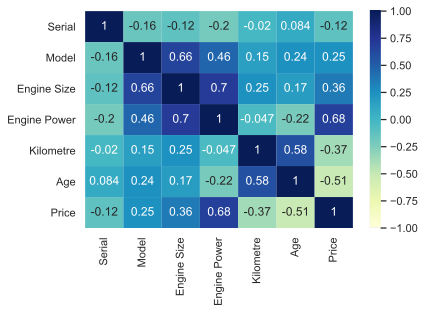

In [217]:
cormatrix= df2.corr()
heatmap = sns.heatmap(cormatrix, cmap='YlGnBu', annot=True, vmin=-1, vmax=1)
sns.set(font_scale=1)
figure = heatmap.get_figure()
figure.savefig('heatmap.jpg', bbox_inches='tight', dpi=200)

In [218]:
df2.drop(columns=['Engine Size'], inplace=True)

In [219]:
df2.sample(10)

,Brand,Serial,Model,Fuel Type,Gear Type,Engine Power,Kilometre,Age,Price
4200,Renault,103,679,LPG & Benzin,Otomatik,110,93300,12,92500
5682,Fiat,171,1048,LPG & Benzin,Düz,147,278800,23,43400
3778,Ford,155,157,Benzin,Düz,60,83000,22,53000
1086,Citroen,87,746,Dizel,Düz,111,190000,10,125500
4396,Hyundai,58,302,LPG & Benzin,Düz,100,284000,5,95000
2046,Volkswagen,191,1035,Benzin,Düz,150,430000,15,173500
1235,Volkswagen,191,861,Dizel,Yarı Otomatik,120,75500,4,345000
5354,Audi,51,1256,LPG & Benzin,Düz,115,140000,14,128000
3275,Citroen,78,734,Dizel,Düz,93,156141,8,112000
3992,Toyota,110,235,Benzin,Düz,100,46000,5,160000


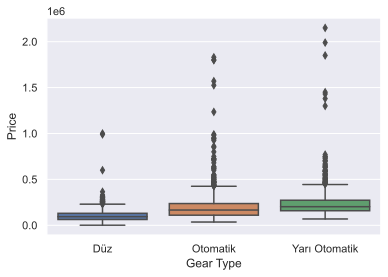

In [220]:
sns.boxplot(x ='Gear Type', y='Price', data=df2);

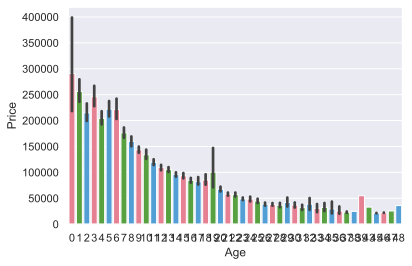

In [160]:
sns.barplot(x ='Age', y='Price', data=df2, palette = sns.color_palette("husl", 3));

In [118]:
sns.pairplot(df2)

In [221]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6107 entries, 0 to 6123
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Brand         6107 non-null   object
 1   Serial        6107 non-null   int32 
 2   Model         6107 non-null   int32 
 3   Fuel Type     6107 non-null   object
 4   Gear Type     6107 non-null   object
 5   Engine Power  6107 non-null   int32 
 6   Kilometre     6107 non-null   int32 
 7   Age           6107 non-null   int32 
 8   Price         6107 non-null   int64 
dtypes: int32(5), int64(1), object(3)
memory usage: 517.8+ KB


In [222]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6107 entries, 0 to 6123
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Marka        6107 non-null   object
 1   Seri         6107 non-null   int32 
 2   Model        6107 non-null   int32 
 3   Yıl          6107 non-null   int32 
 4   Yakıt_tipi   6107 non-null   object
 5   Vites_tipi   6107 non-null   object
 6   Motor_hacmi  6107 non-null   int32 
 7   Motor_gücü   6107 non-null   int32 
 8   Kilometre    6107 non-null   int32 
 9   Price        6107 non-null   int64 
dtypes: int32(6), int64(1), object(3)
memory usage: 541.7+ KB


In [223]:
fig = px.scatter(df.query("Yıl==2019"), x="Marka", y="Price", size="Kilometre", color="Motor_gücü", labels={'Yıl':'Year', 
            'Marka':'Brand', 'Motor_gücü':'Engine Power'},
            size_max=60, title='The Effect of Brand (2019)', template='seaborn')
fig.show()

In [224]:
fig = px.sunburst(df.query("Yıl == 2018"), path=['Marka', 'Price'], 
                  color="Motor_hacmi",  title='Brand and Price Review (2018)', labels={'Motor_hacmi':'Engine Size'})
fig.show()

In [225]:
df2.head()

,Brand,Serial,Model,Fuel Type,Gear Type,Engine Power,Kilometre,Age,Price
0,Ford,140,420,Dizel,Düz,75,137936,10,95750
1,Hyundai,265,376,Benzin,Otomatik,100,22109,3,169750
2,Skoda,185,849,Dizel,Yarı Otomatik,115,31500,3,238900
3,Ford,135,536,Dizel,Düz,75,35500,8,121900
4,Fiat,123,207,Dizel,Düz,95,153000,4,129900


In [230]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6107 entries, 0 to 6123
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Brand         6107 non-null   object
 1   Serial        6107 non-null   int32 
 2   Model         6107 non-null   int32 
 3   Fuel Type     6107 non-null   object
 4   Gear Type     6107 non-null   object
 5   Engine Power  6107 non-null   int32 
 6   Kilometre     6107 non-null   int32 
 7   Age           6107 non-null   int32 
 8   Price         6107 non-null   int64 
dtypes: int32(5), int64(1), object(3)
memory usage: 517.8+ KB


In [232]:
for i in range(len(df2.iloc[:, 8])):
    val1 =df2.iloc[i, 8]
    if  "None" in str(val1):
        df2.iloc[i, 8]=None
    else:
        df2.iloc[i, 8]=val1

In [233]:
final = pd.get_dummies(df2, columns=['Brand', 'Fuel Type', 'Gear Type'])

In [234]:
final.head()

,Serial,Model,Engine Power,Kilometre,Age,Price,Brand_Alfa Romeo,Brand_Audi,Brand_BMW,Brand_Chevrolet,...,Brand_Toyota,Brand_Volkswagen,Brand_Volvo,Fuel Type_Benzin,Fuel Type_Dizel,Fuel Type_Hibrit,Fuel Type_LPG & Benzin,Gear Type_Düz,Gear Type_Otomatik,Gear Type_Yarı Otomatik
0,140,420,75,137936,10,95750,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
1,265,376,100,22109,3,169750,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0
2,185,849,115,31500,3,238900,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
3,135,536,75,35500,8,121900,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
4,123,207,95,153000,4,129900,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0


In [235]:
# Create your feature matrix (X) and target vector (y)
y, X = final['Price'], final.drop('Price',axis=1)

# Create your model
model = sm.OLS(y, X, data=final)

# Fit your model to your training set
fit = model.fit()

# Print summary statistics of the model's performance
print(fit.summary())

                            OLS Regression Results                            
Dep. Variable:                  Price   R-squared:                       0.702
Model:                            OLS   Adj. R-squared:                  0.700
Method:                 Least Squares   F-statistic:                     324.3
Date:                Sun, 01 Aug 2021   Prob (F-statistic):               0.00
Time:                        16:14:25   Log-Likelihood:                -76437.
No. Observations:                6107   AIC:                         1.530e+05
Df Residuals:                    6062   BIC:                         1.533e+05
Df Model:                          44                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Serial                    

In [236]:
X, y = final.drop('Price',axis=1), final['Price']

X_dummyt, X_dummytst, y_dummyt, y_dummytst = train_test_split(X, y, test_size=.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_dummyt, y_dummyt, test_size=.25, random_state=42)

In [237]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_dummyt.values)
X_val_scaled = scaler.transform(X_val.values)
X_test_scaled = scaler.transform(X_dummytst.values)

In [238]:
lm = LinearRegression()
lm.fit(X_dummyt, y_dummyt)
print(f'Linear Regression for all data R^2: {lm.score(X, y):.6f}')
print(f'Linear Regression for test data R^2: {lm.score(X_dummytst, y_dummytst):.6f}')
print(f'Linear Regression for validation data R^2: {lm.score(X_val, y_val):.6f}')
print("")
lm_reg = Ridge(alpha=0.005, normalize=True)
lm_reg.fit(X_train_scaled, y_dummyt)
print(f'Ridge Regression for test data R^2: {lm_reg.score(X_test_scaled, y_dummytst):.6f}')
print(f'Ridge Regression for validation data R^2: {lm.score(X_val_scaled, y_val):.6f}')
print("")
lm_lasso = Lasso(alpha=0.0005, normalize=True)
lm_lasso.fit(X_dummyt, y_dummyt)
print(f'Lasso Regression for test data R^2: {lm_lasso.score(X_dummytst, y_dummytst):.6f}')
print(f'Lasso Regression for validation data R^2: {lm_lasso.score(X_val, y_val):.6f}')
print("")
poly = PolynomialFeatures(degree=2)

Xs_poly = poly.fit_transform(X.values)
X_train_poly = poly.fit_transform(X_dummyt.values)
X_val_poly = poly.transform(X_val.values)
X_test_poly = poly.transform(X_dummytst.values)

lm_poly= LinearRegression()

lm_poly.fit(X_train_poly, y_dummyt)
print(f'Degree 2 polynomial regression for test data R^2: {lm_poly.score(X_test_poly, y_dummytst):.6f}')
print(f'Degree 2 polynomial regression for validation data R^2: {lm_poly.score(X_val_poly, y_val):.6f}')

Linear Regression for all data R^2: 0.700594
Linear Regression for test data R^2: 0.697230
Linear Regression for validation data R^2: 0.687021

Ridge Regression for test data R^2: 0.696823
Ridge Regression for validation data R^2: -29.690069



C:\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:529: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 1641025854317.1973, tolerance: 6869596531.586497



Lasso Regression for test data R^2: 0.697230
Lasso Regression for validation data R^2: 0.687021

Degree 2 polynomial regression for test data R^2: 0.773017
Degree 2 polynomial regression for validation data R^2: 0.920406


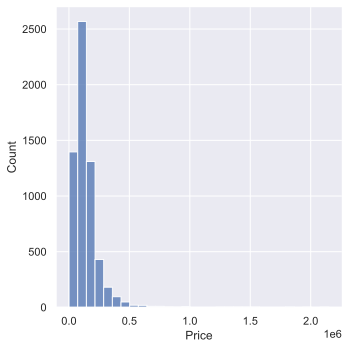

In [239]:
fig=sns.displot(final['Price'],bins=30);
fig.savefig("Priceplot.png")

In [240]:
final['Price_log']=np.log(final.Price)
final.drop('Price',axis=1, inplace=True)

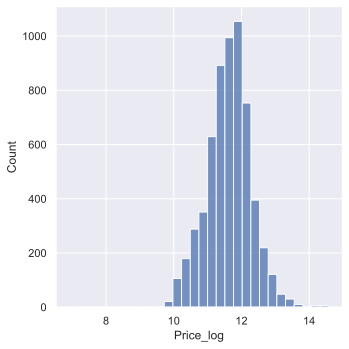

In [241]:
figlog=sns.displot(final['Price_log'],bins=30);
figlog.savefig("Priceplotlog.png")

In [242]:
# Create your feature matrix (X) and target vector (y)
y, X = final['Price_log'], final.drop('Price_log',axis=1)

# Create your model
model = sm.OLS(y, X, data=final)

# Fit your model to your training set
fit = model.fit()

# Print summary statistics of the model's performance
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Price_log   R-squared:                       0.925
Model:                            OLS   Adj. R-squared:                  0.925
Method:                 Least Squares   F-statistic:                     1703.
Date:                Sun, 01 Aug 2021   Prob (F-statistic):               0.00
Time:                        16:15:19   Log-Likelihood:                 1843.6
No. Observations:                6107   AIC:                            -3597.
Df Residuals:                    6062   BIC:                            -3295.
Df Model:                          44                                         
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Serial                   1.099e-05   4.98e-05      0.221      0.825   -8.66e-05       0.000
Model                    7.837e-05   9.84e-06      7.962      0.000    5.91e-05    9.77e-05
Engine Power                0.0050      0.000     46.693      0.000       0.005       0.005
Kilometre               -1.026e-06   3.58e-08    -28.668      0.000    -1.1e-06   -9.56e-07
Age                        -0.0512      0.001    -94.767      0.000      -0.052      -0.050
Brand_Alfa Romeo            0.4814      0.049      9.793      0.000       0.385       0.578
Brand_Audi                  0.8939      0.018     49.582      0.000       0.859       0.929
Brand_BMW                   0.9177      0.016     55.892      0.000       0.885       0.950
Brand_Chevrolet             0.4360      0.021     21.190      0.000       0.396       0.476
Brand_Citroen               0.4449      0.017     25.531      0.000       0.411       0.479
Brand_DS Automobiles        0.5465      0.088      6.220      0.000       0.374       0.719
Brand_Dacia                 0.4119      0.021     19.251      0.000       0.370       0.454
Brand_Fiat                  0.3751      0.011     33.363      0.000       0.353       0.397
Brand_Ford                  0.5691      0.011     53.308      0.000       0.548       0.590
Brand_Geely                 0.1035      0.072      1.440      0.150      -0.037       0.244
Brand_Honda                 0.6791      0.015     46.023      0.000       0.650       0.708
Brand_Hyundai               0.4530      0.012     37.383      0.000       0.429       0.477
Brand_Jaguar                0.7548      0.079      9.531      0.000       0.600       0.910
Brand_Kia                   0.4701      0.026     17.913      0.000       0.419       0.522
Brand_Lada                 -0.0169      0.050     -0.340      0.734      -0.114       0.081
Brand_MINI                  0.7779      0.046     16.922      0.000       0.688       0.868
Brand_Mazda                 0.5857      0.041     14.273      0.000       0.505       0.666
Brand_Mercedes - Benz       1.1050      0.016     67.214      0.000       1.073       1.137
Brand_Mitsubishi            0.6701      0.037     17.973      0.000       0.597       0.743
Brand_Nissan                0.5250      0.030     17.546      0.000       0.466       0.584
Brand_Opel                  0.5865      0.011     54.965      0.000       0.566       0.607
Brand_Peugeot               0.4600      0.015     31.677      0.000       0.431       0.488
Brand_Porsche               1.5978      0.080     19.852      0.000       1.440       1.756
Brand_Proton                0.1419      0.088      1.615      0.106      -0.030       0.314
Brand_Renault               0.5019      0.010     50.894      0.000       0.483       0.521
Brand_Rover                 0.1949      0.072  

In [243]:
X, y = final.drop('Price_log',axis=1), final['Price_log']

X_dummyt, X_dummytst, y_dummyt, y_dummytst = train_test_split(X, y, test_size=.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_dummyt, y_dummyt, test_size=.25, random_state=42)

In [244]:
lm = LinearRegression()
lm.fit(X_dummyt, y_dummyt)
print(f'Linear Regression for all data R^2: {lm.score(X, y):.6f}')
print(f'Linear Regression for test data R^2: {lm.score(X_dummytst, y_dummytst):.6f}')
print(f'Linear Regression for validation data R^2: {lm.score(X_val, y_val):.6f}')
print("")
lm_reg = Ridge(alpha=0.005, normalize=True)
lm_reg.fit(X_train_scaled, y_dummyt)
print(f'Ridge Regression for test data R^2: {lm_reg.score(X_test_scaled, y_dummytst):.6f}')
print(f'Ridge Regression for validation data R^2: {lm.score(X_val_scaled, y_val):.6f}')
print("")
lm_lasso = Lasso(alpha=0.0005, normalize=True)
lm_lasso.fit(X_dummyt, y_dummyt)
print(f'Lasso Regression for test data R^2: {lm_lasso.score(X_dummytst, y_dummytst):.6f}')
print(f'Lasso Regression for validation data R^2: {lm_lasso.score(X_val, y_val):.6f}')
print("")
poly = PolynomialFeatures(degree=2)

Xs_poly = poly.fit_transform(X.values)
X_train_poly = poly.fit_transform(X_dummyt.values)
X_val_poly = poly.transform(X_val.values)
X_test_poly = poly.transform(X_dummytst.values)

lm_poly= LinearRegression()

lm_poly.fit(X_train_poly, y_dummyt)
print(f'Degree 2 polynomial regression for test data R^2: {lm_poly.score(X_test_poly, y_dummytst):.6f}')
print(f'Degree 2 polynomial regression for validation data R^2: {lm_poly.score(X_val_poly, y_val):.6f}')

Linear Regression for all data R^2: 0.925004
Linear Regression for test data R^2: 0.937443
Linear Regression for validation data R^2: 0.929582

Ridge Regression for test data R^2: 0.937475
Ridge Regression for validation data R^2: -5.401345

Lasso Regression for test data R^2: 0.897343
Lasso Regression for validation data R^2: 0.893608

Degree 2 polynomial regression for test data R^2: 0.634000
Degree 2 polynomial regression for validation data R^2: 0.951090


In [245]:
# Run Cross Validation
kf = KFold(n_splits=10, shuffle=True, random_state = 42)
cross_val_score(lm, X, y, cv=kf, scoring='r2')

print('10-Fold Linear Regression:',round(np.mean(cross_val_score(lm, X, y, cv=kf, scoring='r2')),5))
print('10-Fold Ridge Regression:',round(np.mean(cross_val_score(lm_reg, X, y, cv=kf, scoring='r2')),5))
print('10-Fold Lasso Regression:',round(np.mean(cross_val_score(lm_lasso, X, y, cv=kf, scoring='r2')),5))
print('10-Fold Degree 2 Poly. Regression:',round(np.mean(cross_val_score(lm_poly, X, y, cv=kf, scoring='r2')),5))

10-Fold Linear Regression: 0.92406
10-Fold Ridge Regression: 0.92406
10-Fold Lasso Regression: 0.88382
10-Fold Degree 2 Poly. Regression: 0.92406


In [246]:
def final(X,y):
    #Split data into train, validation and  test (%60 - %20 - %20)
    X_dummyt, X_dummytst, y_dummyt, y_dummytst = train_test_split(X, y, test_size=.2, random_state=42)
    X_train, X_val, y_train, y_val = train_test_split(X_dummyt, y_dummyt, test_size=.25, random_state=42)

    rgr = LinearRegression()
    rgr.fit(X_dummyt,y_dummyt)
    pred = rgr.predict(X_dummytst)

    #reg fit plot
    plt.scatter(y_dummytst, pred, alpha=.7)
    plt.plot(np.linspace(10,20,10), np.linspace(10,20,10))
    plt.title("Regression Fit")
    plt.xlabel('Actual Value')
    plt.ylabel('Predicted Value')
    plt.figure(figsize=(20,5))
    fig.savefig("finalpredict.png")

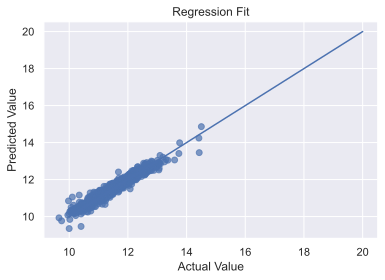

<Figure size 1440x360 with 0 Axes>

In [247]:
figfinal=final(X,y)